# Task Description
In this project, our goal is to train a Clickbait Classifier using our dataset. The aim is to develop a model that can accurately identify clickbait content.

# Problem Statement
The primary question we are addressing is whether our model can reliably and accurately detect clickbait. Our focus is on evaluating the performance of the clickbait classifier we're training on our data.



## <span style="color:#0047AB"> **Source** </span>
https://www.kaggle.com/datasets/amananandrai/clickbait-dataset/data

### <span style="color:#0047AB"> **About the Dataset** </span> <a id="dataset"></a>

The [Clickbait Dataset](https://www.kaggle.com/datasets/amananandrai/clickbait-dataset) from Aman Anand is a dataset that collects data from various news sites.

The clickbait headlines are collected from sites such as `BuzzFeed`, `Upworthy`, `ViralNova`, `Thatscoop`, `Scoopwhoop` and `ViralStories`.
The relevant or non-clickbait headlines are collected from many trustworthy news sites such as `WikiNews`, `New York Times`, `The Guardian`, and `The Hindu`.

It has two columns first one contains headlines and the second one has numerical labels of clickbait in which 1 represents that it is clickbait and 0 represents that it is non-clickbait headline. The dataset contains total 32000 rows of which 50% are clickbait and other 50% are non-clickbait.

| Headline | Clickbait |
| --- | --- |
| contains headlines from news sites in text format | contains numeric labels of which 1 represents it is clickbait and 0 represents non-clickbait |

## <span style="color:#0047AB"> **Data Import** </span> <a id="import"></a>

In [ ]:
import pandas as pd
df=pd.read_csv('https://raw.githubusercontent.com/LetsBigSnack/STML/main/data/clickbait_data.csv')
#df=pd.read_csv('https://raw.githubusercontent.com/LetsBigSnack/STML/main/data/clickbait_data_2.csv')
df

,headline,clickbait
0,Should I Get Bings,1
1,Which TV Female Friend Group Do You Belong In,1
2,"The New ""Star Wars: The Force Awakens"" Trailer...",1
3,"This Vine Of New York On ""Celebrity Big Brothe...",1
4,A Couple Did A Stunning Photo Shoot With Their...,1
...,...,...
31995,"To Make Female Hearts Flutter in Iraq, Throw a...",0
31996,"British Liberal Democrat Patsy Calton, 56, die...",0
31997,Drone smartphone app to help heart attack vict...,0
31998,"Netanyahu Urges Pope Benedict, in Israel, to D...",0


## <span style="color:#0047AB"> **Exploratory Data Analysis** </span> <a id="eda"></a>  
Exploratory data analysis (EDA) is an important step in the machine learning process. EDA helps us understand the data better and identify patterns and trends that may be hidden within it.EDA can also be used to identify potential data issues. It is a good practice to understand the data first and try to gather as many insights from it.

### <span style="color:#0047AB"> **Checking for data structure** </span> <a id="structure"></a>  

In [ ]:
#DataFrame info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32000 entries, 0 to 31999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   headline   32000 non-null  object
 1   clickbait  32000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 500.1+ KB


### <span style="color:#0047AB"> **Checking for Null/Missing values** </span> <a id="null"></a>  

In [ ]:
#checking for missing values
df.isnull().sum()

headline     0
clickbait    0
dtype: int64

### <span style="color:#0047AB"> **Data Visualization** </span> <a id="visual"></a>  

<Axes: xlabel='clickbait', ylabel='count'>

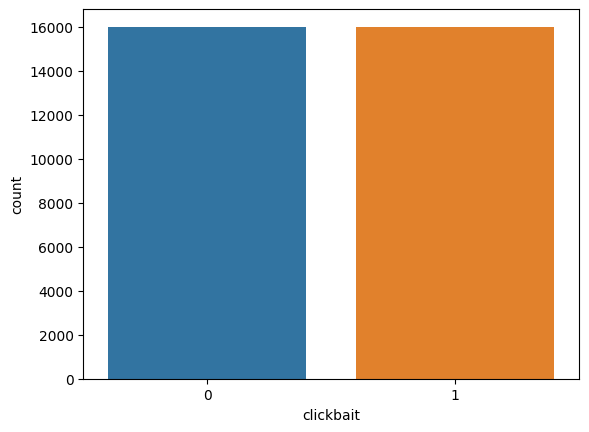

In [ ]:
import seaborn as sns
sns.countplot(x=df.clickbait)

### <span style="color:#0047AB"> **Initial Findings** </span> <a id="findings"></a>
- File has 32000 rows with 2 columns
- No missing/null values in all the columns
- We have balanced dataset, equal number of output(clickbait column) to the input(headline column)
- Count of clickbait (1) to non clickbait (0) is both 16000

## <span style="color:#0047AB"> **Data Preparation** </span> <a id="prepare"></a>
Data preparation is the process by which the data is subjected to various checks and scrutiny in order to remedy issues of missing values, spelling errors, normalizing/standardizing values such that they are comparable and compatible with the algorithm that we will be using.

### <span style="color:#0047AB"> **Removing stop words with NLTK in Python** </span> <a id="stopwords"></a>


In [ ]:
#Importing NLTK library and downloading stopwords
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
# Function creation for data cleanup, data manipulation and removal of stopwords
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
import re



def RemoveSpecialCharacters(sentence):
    return re.sub('[^a-zA-Z]+',' ',sentence)

##Custom Character removal
# def RemoveSpecialCharacters(sentence):
#     return re.sub('[^a-zA-Z0-9!?]+',' ',sentence)



## not converting to lower case improves the performance of the model by a small margin
def ConvertToLowerCase(sentence):
    return sentence.lower()

def ConvertAndRemove(sentence):
    sentence = str(sentence)
    sentence = RemoveSpecialCharacters(sentence)
    # convert to lower case
    sentence = ConvertToLowerCase(sentence)
    return sentence

def CleanText(sentence):
    sentence = str(sentence)

    # Remove stopwords
    STOPWORDS = stopwords.words('english') + ['u', 'ü', 'ur', '4', '2', 'im', 'dont', 'doin', 'ure']
    # Remove punctuation
    nopunc = [char for char in sentence if char not in string.punctuation]
    nopunc = ''.join(nopunc)
    sentence = ' '.join([word for word in nopunc.split() if word.lower() not in STOPWORDS])
    sentence = ConvertAndRemove(sentence)
    return sentence

In [ ]:
#Demonstrating the Text Preprocessing
print(CleanText('This is a headline that is totally not clickbait, unbelievable!!!'))

headline totally clickbait unbelievable


In [ ]:
#Removing Special Characters and transforming text to lower case in the headline column
df['Text_cleaning'] = df.headline.apply(CleanText)
df.tail()

,headline,clickbait,Text_cleaning
31995,"To Make Female Hearts Flutter in Iraq, Throw a...",0,make female hearts flutter iraq throw shoe
31996,"British Liberal Democrat Patsy Calton, 56, die...",0,british liberal democrat patsy calton dies cancer
31997,Drone smartphone app to help heart attack vict...,0,drone smartphone app help heart attack victims...
31998,"Netanyahu Urges Pope Benedict, in Israel, to D...",0,netanyahu urges pope benedict israel denounce ...
31999,Computer Makers Prepare to Stake Bigger Claim ...,0,computer makers prepare stake bigger claim phones


### <span style="color:#0047AB"> **Data Splitting** </span> <a id="split"></a>


In [ ]:
#Define the features (X) and label (Y)
X = df.Text_cleaning
y = df.clickbait

In [ ]:
#Checking the length of our Features and label data before splitting
print('the length of our original training data is:',len(X))
print('the length of our original testing data is:',len(y))

the length of our original training data is: 32000
the length of our original testing data is: 32000


In [ ]:
#Splitting the data into training and testing
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
#checking the new length of training and testing data

print('the length of X_train is now:',len(X_train))
print('the length of X_test is now:',len(X_test))
print('the length of y_train is now:',len(y_train))
print('the length of y_test is now:',len(y_test))

the length of X_train is now: 25600
the length of X_test is now: 6400
the length of y_train is now: 25600
the length of y_test is now: 6400


### <span style="color:#0047AB"> **Text Vectorization** </span> <a id="vector"></a>

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

vect = CountVectorizer()
X_train_dtm = vect.fit_transform(X_train)
X_test_dtm = vect.transform(X_test)

In [ ]:
X_train_dtm

<25600x21436 sparse matrix of type '<class 'numpy.int64'>'
	with 152145 stored elements in Compressed Sparse Row format>

In [ ]:
from sklearn.feature_extraction.text import TfidfTransformer

tfidf_transformer = TfidfTransformer()
X_train_clean = tfidf_transformer.fit_transform(X_train_dtm)

In [ ]:
print(X_train_clean)

  (0, 20691)	0.27874184201961916
  (0, 17768)	0.3345529176182634
  (0, 15408)	0.443280710732536
  (0, 15002)	0.37952311039285885
  (0, 13192)	0.443280710732536
  (0, 12018)	0.32318125012329857
  (0, 5712)	0.30945596770049805
  (0, 3477)	0.2704345505044664
  (1, 19768)	0.4943954061330551
  (1, 19352)	0.6624730736498667
  (1, 8360)	0.5627633686403459
  (2, 19358)	0.398093544057493
  (2, 14980)	0.3044588790043617
  (2, 14484)	0.25078631831387677
  (2, 13284)	0.33813632294469903
  (2, 12879)	0.18494510864592098
  (2, 12716)	0.45227553340304516
  (2, 9559)	0.2966918040963563
  (2, 7673)	0.398093544057493
  (2, 7100)	0.2938265186498573
  (3, 12037)	0.31565021664326437
  (3, 10624)	0.41919574997204595
  (3, 10118)	0.402951847353606
  (3, 8075)	0.2854420765479582
  (3, 7531)	0.3409694430081179
  :	:
  (25596, 11813)	0.5860933147732315
  (25596, 9071)	0.3572209408805257
  (25596, 7075)	0.29993546844497326
  (25596, 6255)	0.43653766312518216
  (25597, 15954)	0.36744333021546094
  (25597, 15204)	

## <span style="color:#0047AB"> **Model Training** </span> <a id="train"></a>
Trying to different classifiers

### <span style="color:#0047AB"> **Commonly Used ML Algorithm for classification** </span> <a id="algo"></a>
1. Logistic Regression
2. Naïve Bayes
3. Stochastic Gradient Descent
4. K-Nearest Neighbours
5. Decision Tree
6. Random Forest
7. Support Vector Machine

In [ ]:
#Import ML algorithm from Scikit learn library
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline
from sklearn import metrics

In [ ]:
Classifiers = [
{
   'label': 'Logistic Regression',
   'model': LogisticRegression(C=0.00000001,solver='liblinear',max_iter=200, multi_class='auto'),
},
{
    'label': 'SGD Classifier',
    'model': SGDClassifier(loss='log', warm_start=True, max_iter=1000, l1_ratio=0.03, penalty='l2', alpha=1e-4, fit_intercept=False),
},
{
    'label': 'KNeighbours',
    'model': KNeighborsClassifier(n_neighbors=15),
},
{
    'label': 'Decision Tree',
    'model': DecisionTreeClassifier(max_depth=10,random_state=101,max_features= None,min_samples_leaf=15),
},
{
   'label': 'Random Forest',
   'model': RandomForestClassifier(n_estimators=70, oob_score=True, n_jobs=-1,random_state=101,max_features= None,min_samples_leaf = 30),
}
]

In [ ]:
Accuracy=[]
Model=[]
prediction = []
for c in Classifiers:
    try:
        classifier = c['model']
        fit = classifier.fit(X_train_clean, y_train)
        pred = fit.predict(X_test_dtm)
    except Exception:
        fit = classifier.fit(X_train_clean, y_train)
        pred = fit.predict(X_test_dtm)
    prediction.append(pred)
    accuracy = accuracy_score(pred,y_test)
    Accuracy.append(accuracy)
    Model.append(c['label'])
    print('Accuracy of '+c['label']+' is '+str(accuracy))

Accuracy of Logistic Regression is 0.68390625
Accuracy of SGD Classifier is 0.9428125


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(


Accuracy of KNeighbours is 0.8678125
Accuracy of Decision Tree is 0.6415625
Accuracy of Random Forest is 0.8153125


## <span style="color:#0047AB"> **Model Evaluation** </span> <a id="eval"></a>
Different quantitative and/or qualitative evaluation metrics should be used to prove the efficacy of the trained model. We will be evaluating results of the 5 trained models.

Commonly used metrics are
- accuracy
- confusion matrix
- precision
- recall
- F1 score
- Area under Curve – Receiver operation characteristics (AUCROC)


### <span style="color:#0047AB"> **Compare the model performances** </span> <a id="compare"></a>

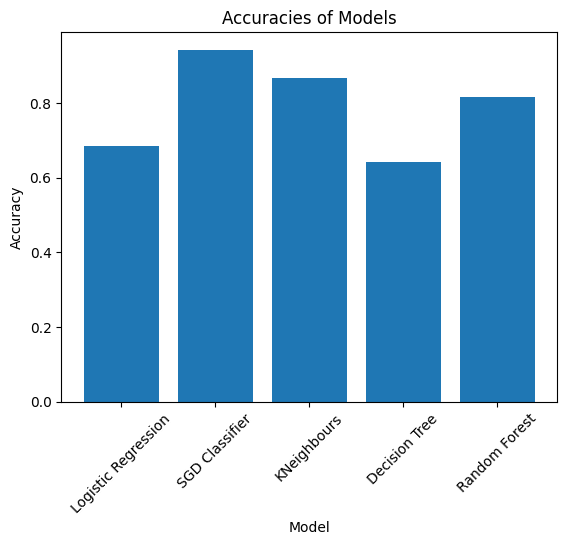

In [ ]:
import matplotlib.pyplot as plt
Index = [1,2,3,4,5]
plt.bar(Index,Accuracy)
plt.xticks(Index, Model,rotation=45)
plt.ylabel('Accuracy')
plt.xlabel('Model')
plt.title('Accuracies of Models')
plt.show()

###   <span style="color:#0047AB"> **Confusion Matrix** </span> <a id="matrix"></a>
A table showing correct predictions and types of incorrect predictions.

In [ ]:
from sklearn.metrics import confusion_matrix

# test = confusion_matrix(y_test,prediction[1]).ravel()
# test
for p in prediction:
    true_negative, false_positive, false_negative , true_positive = confusion_matrix(y_test,p).ravel()
    print(true_negative, false_positive, false_negative , true_positive)

3116 11 2012 1261
2945 182 187 3086
2331 796 50 3223
3082 45 2249 1024
2821 306 876 2397


###   <span style="color:#0047AB"> **Confusion Matrix Visuals** </span> <a id="matrix_visual"></a>

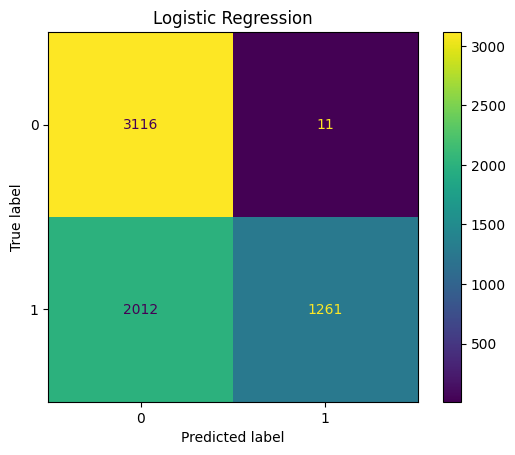

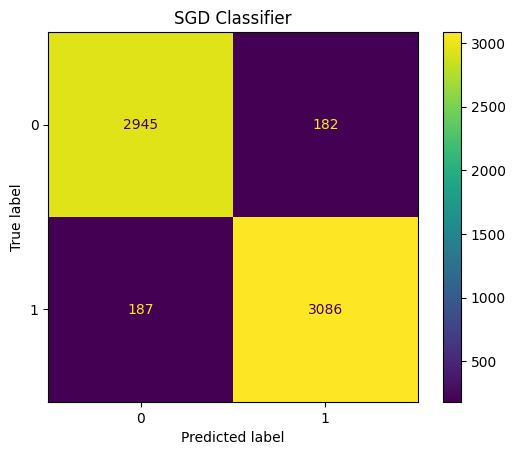

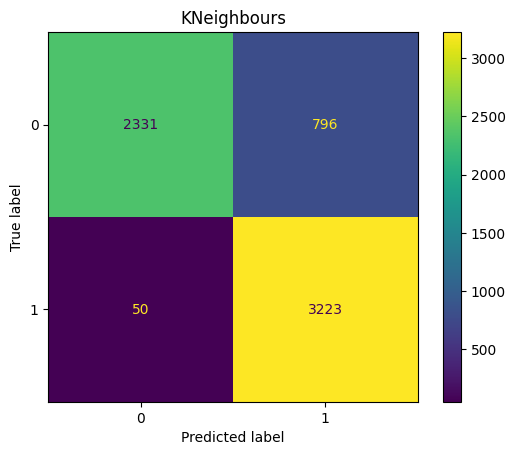

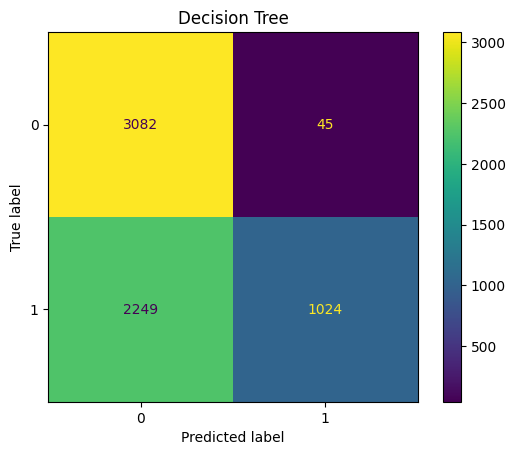

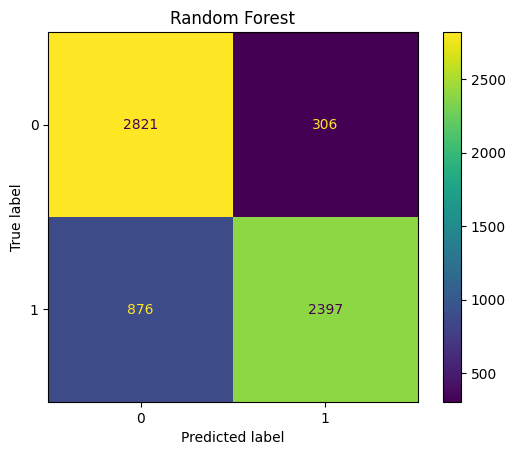

In [ ]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.metrics import ConfusionMatrixDisplay

for i,p in enumerate(prediction):
    cm = confusion_matrix(y_test, p, labels=fit.classes_)
    disp = ConfusionMatrixDisplay(cm)
    disp.plot(values_format='g')
    disp.ax_.set_title(Classifiers[i]['label'])

plt.show()

###   <span style="color:#0047AB"> **Precision** </span> <a id="precision"></a>
The precision is the ratio tp / (tp + fp) where tp is the number of true positives and fp the number of false positives. Precision is also called Positive Predictive Value. It is a measure of a classifier’s exactness. Low precision indicates a high number of false positives.

In [ ]:
from sklearn.metrics import precision_score

for i,p in enumerate(prediction):
    prec_score = precision_score(y_test, p, average='weighted')
    print(f"The precision score of {Classifiers[i]['label']} is {prec_score}")


The precision score of Logistic Regression is 0.8038749216979292
The precision score of SGD Classifier is 0.9423468864871208
The precision score of KNeighbours is 0.8884510141362861
The precision score of Decision Tree is 0.77234808479192
The precision score of Random Forest is 0.8263332122297018


###   <span style="color:#0047AB"> **Recall or Sensitivity** </span> <a id="recall"></a>
The ratio tp / (tp + fn) where tp is the number of true positives and fn the number of false negatives. The recall is also called Sensitivity or the True Positive Rate. It is a measure of a classifier’s completeness. Low recall indicates a high number of false negatives.

In [ ]:
from sklearn.metrics import recall_score

for i,p in enumerate(prediction):
    recall = recall_score(y_test, p, average='weighted')
    print(f"The recall score of {Classifiers[i]['label']} is {recall}")

The recall score of Logistic Regression is 0.68390625
The recall score of SGD Classifier is 0.94234375
The recall score of KNeighbours is 0.8678125
The recall score of Decision Tree is 0.6415625
The recall score of Random Forest is 0.8153125


###   <span style="color:#0047AB"> **F1: Score** </span> <a id="f1"></a>
The F1 score can be interpreted as a harmonic mean of the precision and recall, where an F1 score reaches its best value at 1 and worst score at 0.

In [ ]:
from sklearn.metrics import f1_score

for i,p in enumerate(prediction):
    f1 = f1_score(y_test, p, average='weighted')
    print(f"The F1 score of {Classifiers[i]['label']} is {f1}")

The F1 score of Logistic Regression is 0.6526342292050222
The F1 score of SGD Classifier is 0.9423447428563287
The F1 score of KNeighbours is 0.8656224527775089
The F1 score of Decision Tree is 0.5972921556322573
The F1 score of Random Forest is 0.8142179676354891


###   <span style="color:#0047AB"> **Area Under Curve - Receiver operating characteristic (AUCROC)** </span> <a id="auc"></a>
Represents the likelihood of your model distinguishing observations from two classes. In other words, if you randomly select one observation from each class, what’s the probability that your model will be able to “rank” them correctly?

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(


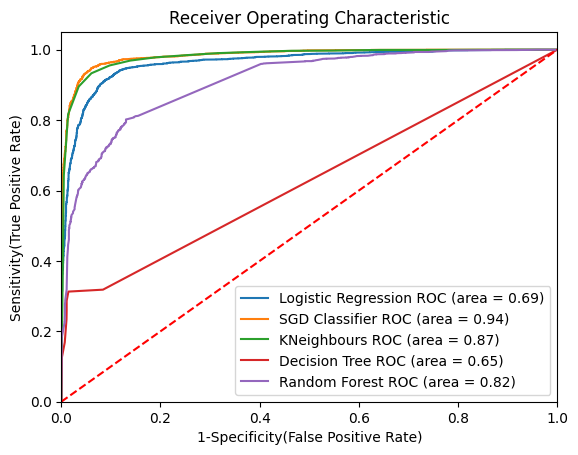

In [ ]:

from sklearn import metrics
import matplotlib.pyplot as plt

plt.figure()

# Below for loop iterates through your models list
for m in Classifiers:
    model = m['model'] # select the model
    model.fit(X_train_clean, y_train) # train the model
    y_pred=model.predict(X_test_dtm) # predict the test data
# Compute False postive rate, and True positive rate
    fpr, tpr, thresholds = metrics.roc_curve(y_test, model.predict_proba(X_test_dtm)[:,1])
# Calculate Area under the curve to display on the plot
    auc = metrics.roc_auc_score(y_test,model.predict(X_test_dtm))
# Now, plot the computed values
    plt.plot(fpr, tpr, label='%s ROC (area = %0.2f)' % (m['label'], auc))
# Custom settings for the plot
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('1-Specificity(False Positive Rate)')
plt.ylabel('Sensitivity(True Positive Rate)')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()   # Display

# Rationale for the Chosen Methodology
Our decision to adopt the Stochastic Gradient Descent (SGD) Classifier as the primary model for this task is underpinned by a meticulous analysis of various evaluation metrics, aligning with insights garnered from the state-of-the-art literature.

1. High Accuracy (94.23%):

SGD Classifier emerged as the frontrunner with an impressive accuracy of 94.23%. This vital metric indicates the model's overall correctness in classifying clickbait titles and is a pivotal factor in model selection.

2. Confusion Matrix Analysis:

Upon scrutinizing the confusion matrix, SGD exhibited superior performance by yielding the highest number of true negatives/positives and the least number of false negatives/positives. This comprehensive evaluation ensures the robustness of SGD across different aspects of classification.

3. Precision, Recall, and F1 Score (94.23% each):

SGD not only excelled in accuracy but also demonstrated unmatched precision, recall, and F1 score, all set at an impressive 94.23%. These metrics collectively highlight the model's ability to precisely identify clickbait instances while minimizing false positives and negatives.

4. Receiver Operating Characteristic (ROC) Analysis (94%):

The SGD Classifier outshone its counterparts with the highest ROC of 94%. This metric, vital in assessing the model's ability to discriminate between classes, reaffirms the superior discriminatory power of SGD.
Drawing from a comprehensive review of the literature, our selection of the SGD Classifier is not merely based on numeric superiority but is substantiated by its consistent outperformance across diverse evaluation criteria. The alignment of our findings with established research underscores the robustness and efficacy of the chosen methodology in the context of clickbait classification.








## <span style="color:#0047AB"> **Model Testing** </span> <a id="test"></a>
In this testing phase, we will be using **pipeline**, a set of tasks happening in sequence, where the output of a task becomes the input of the next one, until it outputs the final product at the end.
The sequence of our pipeline will be same from what we have done during the training phase.
- converting the clean text columng to numbers using **CountVectorizer** and then **TfidTransformer**
- model training with the selected classifier

We will be using the SGD Classifier model that we have trained in testing since it has the highest evaluation metrics

In [ ]:
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.pipeline import Pipeline

pipe = Pipeline([('bow', CountVectorizer()),
                 ('tfid', TfidfTransformer()),
                 ('model', Classifiers[1]['model'])])
pipe.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(


Pipeline(steps=[('bow', CountVectorizer()), ('tfid', TfidfTransformer()),
                ('model',
                 SGDClassifier(fit_intercept=False, l1_ratio=0.03, loss='log',
                               warm_start=True))])

In [ ]:
y_pred = pipe.predict(X_test)

In [ ]:
#sample clickbait from the dataset
test_sample1=['The New Star Wars: The Force Awakens Trailer Is Here To Give You Chills']

#sample not a clickbait from the dataset
test_sample2 = ['Scientology defector arrested after attempting to leave organization']

#made up sample, expected to be clickbait
test_sample3 =['Hurry grab our promo now!']

test_sample4=['The rights you might not realize you have - Shannon Odell']

many_titles = [
    "You Won't Believe What This Celebrity Ate for Breakfast!",
    "Shocking Secrets Your Doctor Doesn't Want You to Know!",
    "10 Mind-Blowing Tricks to Get Rich Overnight!",
    "This Simple Trick Will Make You Lose 20 Pounds in a Week!",
    "Aliens Found? The Government Is Hiding the Truth!",
    "New Study Reveals a Miracle Cure for Aging!",
    "The One Thing You Should Never Eat—It's Killing You Slowly!",
    "Is Your Partner Cheating? Find Out Now with This App!",
    "Secret Government Plot Exposed: You're in Danger!",
    "Unbelievable! Man Survives a Shark Attack Using This Household Item!",
    "Understanding the Benefits of Regular Exercise for Your Health",
    "Tips for Effective Time Management in a Busy World",
    "Exploring the Latest Advances in Renewable Energy",
    "The Impact of Social Media on Mental Health",
    "Interview with Expert: Navigating Career Changes Successfully",
    "Recent Scientific Discoveries in Space Exploration",
    "Local Community Event Aims to Combat Hunger",
    "Guide to Healthy Eating Habits for Long-Term Wellness",
    "How to Improve Sleep Quality",
    "Exploring Different Meditation Techniques for Stress Relief",
    "You won't believe what happened next",
    "10 Shocking Secrets That Will Change Your Life",
    "The One Thing You're Doing Wrong and How to Fix It",
    "The Top 5 Most Surprising (Insert topic here) of All Time",
    "The One Thing That Can Make or Break (Insert topic here)",
]

prediction = pipe.predict(many_titles)

for i in range(len(prediction)):
  if prediction[i] == 0:
    result = 'Not Clickbait'
  else:
    result = 'Clickbait'
  print(f'{result} -> {many_titles[i]}')

Clickbait -> You Won't Believe What This Celebrity Ate for Breakfast!
Clickbait -> Shocking Secrets Your Doctor Doesn't Want You to Know!
Clickbait -> 10 Mind-Blowing Tricks to Get Rich Overnight!
Clickbait -> This Simple Trick Will Make You Lose 20 Pounds in a Week!
Not Clickbait -> Aliens Found? The Government Is Hiding the Truth!
Not Clickbait -> New Study Reveals a Miracle Cure for Aging!
Clickbait -> The One Thing You Should Never Eat—It's Killing You Slowly!
Clickbait -> Is Your Partner Cheating? Find Out Now with This App!
Not Clickbait -> Secret Government Plot Exposed: You're in Danger!
Not Clickbait -> Unbelievable! Man Survives a Shark Attack Using This Household Item!
Not Clickbait -> Understanding the Benefits of Regular Exercise for Your Health
Clickbait -> Tips for Effective Time Management in a Busy World
Not Clickbait -> Exploring the Latest Advances in Renewable Energy
Not Clickbait -> The Impact of Social Media on Mental Health
Not Clickbait -> Interview with Expert:

# Explainability

In [ ]:
# Install lime & shap
!pip install lime
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=81b808d6a1c61bbb772dda72a05aa7bf7b4dadacc515e0e3ecaba8ee7ddae75c
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 533.5/533.5 kB 11.0 MB/s eta 0:00:00


In [ ]:
# LIME and SHAP Imports
import lime
import sklearn.ensemble
from lime import lime_text
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer
from lime import lime_text
from lime.lime_text import LimeTextExplainer
import shap

## LIME

In [ ]:
# LIME - Explaining a Prediction
explainer = LimeTextExplainer(class_names=['Not Clickbait', 'Clickbait'])
idx = 1  # Index of the sample you want to explain

for i in range(len(many_titles)):
  exp = explainer.explain_instance(CleanText(many_titles[i]), pipe.predict_proba)
  exp.show_in_notebook(text=True)

## SHAP

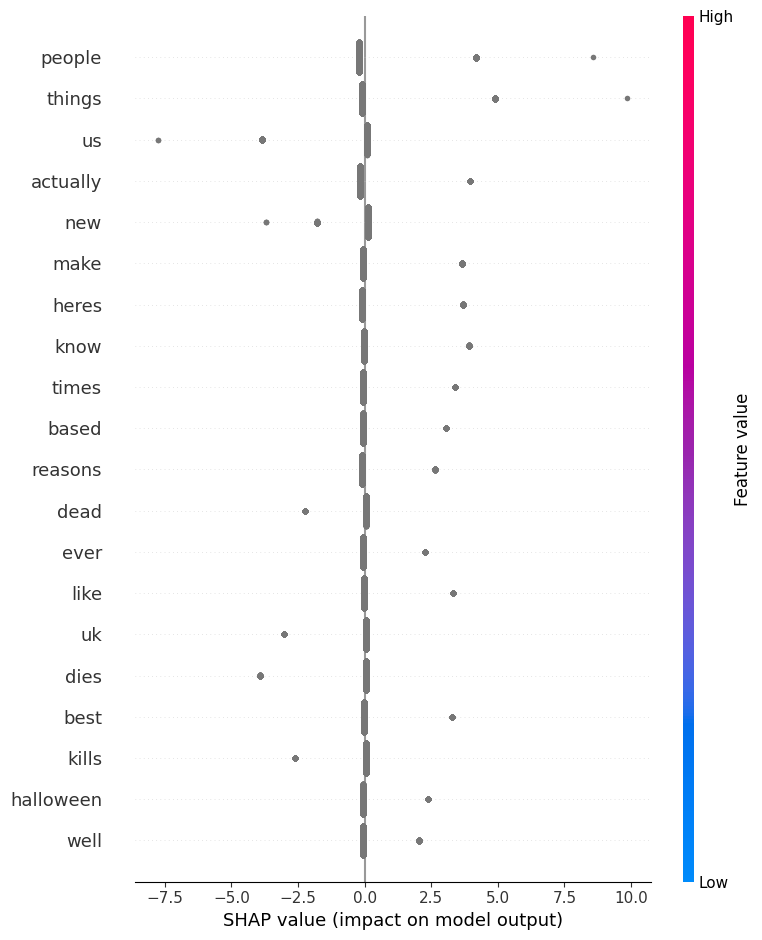

In [ ]:

# Create a SHAP explainer using the model in the pipeline
explainer = shap.Explainer(pipe.named_steps['model'], pipe.named_steps['bow'].transform(X_train))
# Compute SHAP values for a sample of the test set
shap_values = explainer.shap_values(pipe.named_steps['bow'].transform(X_test))
# Visualize the SHAP values - Summary plot
shap.summary_plot(shap_values, pipe.named_steps['bow'].transform(X_test), feature_names=vect.get_feature_names_out())


# Discussion & Conclusion

Our exploration into clickbait classification was successfull. The models performed with a high accuracy. Leveraging advanced interpretability techniques such as Shapley values (Shap) and Local Interpretable Model-agnostic Explanations (LIME), we gained valuable insights into the decision-making processes of the model.

By understanding the key features and patterns that contribute to clickbait detection, we not only enhanced the transparency of our model but also laid the foundation for future improvements. Shap and LIME provided us with a window into the inner workings of the model, allowing us to identify and address potential biases or areas for optimization, like the cleanup of the data.

In conclusion, this project not only accomplished its initial goal of creating an effective clickbait classifier but also sparked innovation in the form of a user-centric WebApp.
